In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import numpy as np
from datetime import datetime
from nltk.stem import PorterStemmer
import math
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords 
from nltk.tokenize import RegexpTokenizer
import nltk
nltk.download('punkt')
from nltk.stem import WordNetLemmatizer
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
import seaborn as sns
import matplotlib.pyplot as plt

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


# Reading json

In [ ]:
import json
# Opening JSON file
f = open('/content/drive/MyDrive/RS/raw json file/reviews.clean.json')
# data = json.load(f) 
x = f.readlines()

In [ ]:
print(len(x))

11453845


# dividing dataset into small parts

1st set

In [ ]:
final_dict = {}
for i in range(0,2000000):
  d = eval(x[i])
  final_dict[i] = d

In [ ]:
df1 = pd.DataFrame.from_dict(final_dict, orient ='index') 
df1

,rating,reviewerName,reviewText,categories,gPlusPlaceId,unixReviewTime,reviewTime,gPlusUserId
0,3.0,an lam,Chất lượng tạm ổn,[Giải Trí - Café],108103314380004200232,1.372687e+09,"Jul 1, 2013",100000010817154263736
1,5.0,HALİL TURGUT,Wc si temiz duzenli..,[Turkish Cuisine],102194128241608748649,1.342871e+09,"Jul 21, 2012",100000013500285534661
2,5.0,森田さとこ,何回も私は予定に休みがセルバに行ったので覚えて見て、分かります❗,"[Fishing, Pond Fish Supplier, Seafood Market]",101409858828175402384,1.390654e+09,"Jan 25, 2014",100000021336848867366
3,5.0,森田さとこ,今度は予定に休みが登米市に行きたい❗☀😅🌌 楽しいに日帰りに登米の見学の観光(*^)(*^-...,[Museum],101477177500158511502,1.389188e+09,"Jan 8, 2014",100000021336848867366
4,4.0,森田さとこ,気仙沼警察署に移転中に絆 👮🐎☺🙋🚓頑張ろう❗,[Police],106994170641063333085,1.390486e+09,"Jan 23, 2014",100000021336848867366
...,...,...,...,...,...,...,...,...
1999995,2.0,Amber Huang,None,"[Cemetery, Tourist Attraction]",104001398223646834689,1.365128e+09,"Apr 4, 2013",103186092751685235480
1999996,3.0,Rajesh Kumawat,Good hi h,[Entertainment],113945475154206060146,1.381681e+09,"Oct 13, 2013",103186093383379884621
1999997,3.0,Robert Ewing,It certainly has the home town feel and everyo...,[Restaurant],100262995125825255252,1.388197e+09,"Dec 27, 2013",103186096705093758898
1999998,4.0,Robert Ewing,This is the site of real history that really m...,[State Park],113249899068270935270,1.389236e+09,"Jan 8, 2014",103186096705093758898


In [ ]:
df1.to_pickle('./reviews_unclear_1.pkl')

2nd set

In [ ]:
final_dict = {}
for i in range(2000000,4000000):
  d = eval(x[i])
  final_dict[i] = d

In [ ]:
df2 = pd.DataFrame.from_dict(final_dict, orient ='index') 
df2

In [ ]:
df2.to_pickle('./reviews_unclear_2.pkl')

3rd set

In [ ]:
final_dict = {}
for i in range(4000000,6000000):
  d = eval(x[i])
  final_dict[i] = d

In [ ]:
df3 = pd.DataFrame.from_dict(final_dict, orient ='index') 
df3

In [ ]:
df3.to_pickle('./reviews_unclear_3.pkl')

4th set

In [ ]:
final_dict = {}
for i in range(6000000,8000000):
  d = eval(x[i])
  final_dict[i] = d

In [ ]:
df4 = pd.DataFrame.from_dict(final_dict, orient ='index') 
df4

In [ ]:
df4.to_pickle('./reviews_unclear_3.pkl')

5th set

In [ ]:
final_dict = {}
for i in range(8000000,11453845):
  d = eval(x[i])
  final_dict[i] = d

In [ ]:
df5 = pd.DataFrame.from_dict(final_dict, orient ='index') 
df5

In [ ]:
df5.to_pickle('./reviews_unclear_3.pkl')

# reading five files and removing null values,and reviews of other languages and making two files combining 123 and 45

In [ ]:
df1 = pd.read_pickle('/content/drive/MyDrive/RS/reviews_unclear_1.pkl')
df1 = df1[df1['reviewerName'].map(lambda x: x.isascii())]
df1 = df1.loc[~df1['reviewText'].isnull()]
df1 = df1[df1['reviewText'].map(lambda x: x.isascii())]

In [ ]:
df2 = pd.read_pickle('/content/drive/MyDrive/RS/reviews_unclear_2.pkl')
df2 = df2[df2['reviewerName'].map(lambda x: x.isascii())]
df2 = df2.loc[~df2['reviewText'].isnull()]
df2 = df2[df2['reviewText'].map(lambda x: x.isascii())]

In [ ]:
df3 = pd.read_pickle('/content/drive/MyDrive/RS/reviews_unclear_3.pkl')
df3 = df3[df3['reviewerName'].map(lambda x: x.isascii())]
df3 = df3.loc[~df3['reviewText'].isnull()]
df3 = df3[df3['reviewText'].map(lambda x: x.isascii())]

In [ ]:
frames = [df1, df2,df3]
result = pd.concat(frames)
result.to_pickle('./reviews_merged_123.pkl')

In [ ]:
df4 = pd.read_pickle('/content/drive/MyDrive/RS/reviews_unclear_4.pkl')
df4 = df4[df4['reviewerName'].map(lambda x: x.isascii())]
df4 = df4.loc[~df4['reviewText'].isnull()]
df4 = df4[df4['reviewText'].map(lambda x: x.isascii())]

In [ ]:
df5 = pd.read_pickle('/content/drive/MyDrive/RS/reviews_unclear_5.pkl')
df5 = df5[df5['reviewerName'].map(lambda x: x.isascii())]
df5 = df5.loc[~df5['reviewText'].isnull()]
df5 = df5[df5['reviewText'].map(lambda x: x.isascii())]

In [ ]:
frames = [df4, df5]
result = pd.concat(frames)
result.to_pickle('./reviews_merged_45.pkl')

# taking only restaurant data from merged file 123 and 45 and combining them and converting them to lower case,removing stop words

In [ ]:
df1 = pd.read_pickle('/content/drive/MyDrive/RS/reviews_marged_123.pkl')

In [ ]:
df1

,rating,reviewerName,reviewText,categories,gPlusPlaceId,unixReviewTime,reviewTime,gPlusUserId
13,4.0,william spindler,Best War Wanton soup in Red Bluff,"[Asian Restaurant, Chinese Restaurant]",106591714648856494903,1394669496,"Mar 12, 2014",100000032416892623125
14,5.0,william spindler,This is a review that is long overdo. I've bee...,"[European Restaurant, Italian Restaurant, Pizz...",109420033090810328045,1394826388,"Mar 14, 2014",100000032416892623125
15,5.0,william spindler,"Some authentic rub BBQ, great food and don't m...",[Barbecue Restaurant],111623070919810985923,1394671215,"Mar 12, 2014",100000032416892623125
16,4.0,william spindler,Truly a Red Bluff standard. Great old fashione...,[Restaurant],113854191152597312098,1394670357,"Mar 12, 2014",100000032416892623125
17,5.0,william spindler,"Long time favorite Mexican food, always consis...",[Mexican Restaurant],115827996910815192564,1394669713,"Mar 12, 2014",100000032416892623125
...,...,...,...,...,...,...,...,...
5999989,5.0,Jagoda Nowak,Ja z chamsko !,None,117101095370472282663,None,None,109607100674600991176
5999992,3.0,Amy Nickodemus,Cashier was having a personal phone conversati...,"[Service Station, Convenience Store]",111569883190681199096,1355714088,"Dec 16, 2012",109607107390549824661
5999993,2.0,Amy Nickodemus,I have finally given up on this place. I use t...,"[Bakery, Dessert Shop, Donut Shop]",112665983297705032354,1355713804,"Dec 16, 2012",109607107390549824661
5999997,5.0,Du Silva,atendimento muito bom,"[Deli, Bakery]",107078797872607190616,1369840292,"May 29, 2013",109607121603841825803


In [ ]:
df1['reviewerName'] = df1.apply(lambda x: x['reviewerName'].lower(), axis=1)
df1['reviewText'] = df1.apply(lambda x: str(x['reviewText']).lower(), axis=1)

In [ ]:
for idx, row in df1.iterrows():
    vals = row['categories']
    try:
        vals = [val.lower() for val in vals]
        df1.at[idx, 'categories'] = vals
    except Exception as e:
        df1.at[idx, 'categories'] = 'no category'

In [ ]:
# convert all the reviewTimes to datetime objects
#for idx, row in df1.iterrows():
#    dt = row['reviewTime']
#    df1.at[idx, 'reviewTime'] = datetime.strptime(dt, '%b %d, %Y')
#    udt = row['unixReviewTime']
#    df1.at[idx, 'unixReviewTime'] = datetime.fromtimestamp(udt)

In [ ]:
# Removing the stop words
from nltk.corpus import stopwords
stopwords = stopwords.words('english')
def remove_stopwords(text):
    clean_text=' '.join([word for word in text.split() if word not in stopwords])
    return clean_text
df1['reviewText'] = df1['reviewText'].apply(lambda text : remove_stopwords(text.lower()))
df1.shape

(3260059, 8)

In [ ]:
# Removing Punctuations, Numbers, and Special Characters
df1['reviewText'] = df1['reviewText'].str.replace("[^a-zA-Z]"," ")

<ipython-input-9-9071d5bcee4b>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df1['reviewText'] = df1['reviewText'].str.replace("[^a-zA-Z]"," ")


In [ ]:
restaurant_list = []
# convert all the categories to lower case
for idx, row in df1.iterrows():
    vals = row['categories']
    flag = 0
    try:
        for val in vals:
            if 'restaurant' in val or 'bar' in val or 'cafe' in val or 'ice cream' in val or 'bistro' in val or 'chinese' in val or 'italian' in val or 'pizza' in val or 'asian' in val or 'food' in val or 'Southeast' in val: 
                flag = 1
        if flag == 1:
            restaurant_list.append(list(row))
    except Exception as e:
        pass

In [ ]:
df_1 = pd.DataFrame(restaurant_list)

In [ ]:
df2 = pd.read_pickle('/content/drive/MyDrive/RS/reviews_merged_45.pkl')

In [ ]:
df2['reviewerName'] = df2.apply(lambda x: x['reviewerName'].lower(), axis=1)
df2['reviewText'] = df2.apply(lambda x: str(x['reviewText']).lower(), axis=1)

In [ ]:
for idx, row in df2.iterrows():
    vals = row['categories']
    try:
        vals = [val.lower() for val in vals]
        df2.at[idx, 'categories'] = vals
    except Exception as e:
        df2.at[idx, 'categories'] = 'no category'

In [ ]:
# Removing the stop words
from nltk.corpus import stopwords
stopwords = stopwords.words('english')
def remove_stopwords(text):
    clean_text=' '.join([word for word in text.split() if word not in stopwords])
    return clean_text
df2['reviewText'] = df2['reviewText'].apply(lambda text : remove_stopwords(text.lower()))
df2.shape

(2974171, 8)

In [ ]:
# Removing Punctuations, Numbers, and Special Characters
df2['reviewText'] = df2['reviewText'].str.replace("[^a-zA-Z]","")

<ipython-input-16-02a4d44acfb1>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df2['reviewText'] = df2['reviewText'].str.replace("[^a-zA-Z]","")


In [ ]:
restaurant_list = []
# convert all the categories to lower case
for idx, row in df2.iterrows():
    vals = row['categories']
    flag = 0
    try:
        for val in vals:
            if 'restaurant' in val or 'bar' in val or 'cafe' in val or 'ice cream' in val or 'bistro' in val or 'chinese' in val or 'italian' in val or 'pizza' in val or 'asian' in val or 'food' in val or 'Southeast' in val: 
                flag = 1
        if flag == 1:
            restaurant_list.append(list(row))
    except Exception as e:
        pass

In [ ]:
df_2 = pd.DataFrame(restaurant_list)

In [ ]:
frames = [df_1, df_2]
result = pd.concat(frames)
result.to_pickle('./reviews_restaurants_all.pkl')

In [ ]:
len(result)

2258141

# EDA

## Review Dataset

In [ ]:
df = pd.read_pickle("/content/drive/MyDrive/RS_Assignment_1/reviews_merged_12345.pkl")

In [ ]:
df

,rating,reviewerName,reviewText,categories,gPlusPlaceId,unixReviewTime,reviewTime,gPlusUserId
13,4.0,william spindler,Best War Wanton soup in Red Bluff,"[Asian Restaurant, Chinese Restaurant]",106591714648856494903,1394669496,"Mar 12, 2014",100000032416892623125
14,5.0,william spindler,This is a review that is long overdo. I've bee...,"[European Restaurant, Italian Restaurant, Pizz...",109420033090810328045,1394826388,"Mar 14, 2014",100000032416892623125
15,5.0,william spindler,"Some authentic rub BBQ, great food and don't m...",[Barbecue Restaurant],111623070919810985923,1394671215,"Mar 12, 2014",100000032416892623125
16,4.0,william spindler,Truly a Red Bluff standard. Great old fashione...,[Restaurant],113854191152597312098,1394670357,"Mar 12, 2014",100000032416892623125
17,5.0,william spindler,"Long time favorite Mexican food, always consis...",[Mexican Restaurant],115827996910815192564,1394669713,"Mar 12, 2014",100000032416892623125
...,...,...,...,...,...,...,...,...
11453827,2.0,charles mckinney,Too expensive for a fast food burger.,"[Hamburger Restaurant, Fast Food Restaurant]",116458473784504954830,1364706351,"Mar 30, 2013",118446742455312620560
11453829,2.0,charles mckinney,Too many gangs frequent this place.,[Flea Market],116649125736549598195,1367212161,"Apr 28, 2013",118446742455312620560
11453834,1.0,charles mckinney,i will never go back. food and customer servic...,"[Buffet Restaurant, American Restaurant]",117952004983617019485,1315602371,"Sep 9, 2011",118446742455312620560
11453843,5.0,Karen Martin,The MOST amazing homemade ice cream in North W...,None,106919006909432779494,None,None,118446743745545869532


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6234230 entries, 13 to 11453844
Data columns (total 8 columns):
 #   Column          Dtype 
---  ------          ----- 
 0   rating          object
 1   reviewerName    object
 2   reviewText      object
 3   categories      object
 4   gPlusPlaceId    object
 5   unixReviewTime  object
 6   reviewTime      object
 7   gPlusUserId     object
dtypes: object(8)
memory usage: 428.1+ MB


In [ ]:
df.isna().sum()

rating                 0
reviewerName           0
reviewText             0
categories        491419
gPlusPlaceId           0
unixReviewTime    450861
reviewTime        450861
gPlusUserId            0
dtype: int64

#### We are not interested in the missing values in categoies as these are not going to be used in the modeling.

In [ ]:
df = df.loc[df.categories.isna()==False].reset_index(drop=True)
df.isna().sum()

rating            0
reviewerName      0
reviewText        0
categories        0
gPlusPlaceId      0
unixReviewTime    0
reviewTime        0
gPlusUserId       0
dtype: int64

In [ ]:
df.shape

(5742811, 8)

### Visualization of ratings distribution

In [ ]:
import plotly.graph_objects as go

In [ ]:
rating_array = df['rating'].tolist()
rating_array = np.array(rating_array)
rating_array

array([4., 5., 5., ..., 2., 2., 1.])

In [ ]:
fig = go.Figure(data=[go.Histogram(x=rating_array, histnorm='probability', marker_color='#330C73', opacity=0.75)])
fig.update_layout(
    title_text='The ratio of reviews ratings in California', # title of plot
    xaxis_title_text='Ratings', # xaxis label
    yaxis_title_text='Ratio', # yaxis label
)

fig.show()

### Visulization of business categories distribution
get top 20 categories

In [ ]:
import plotly.express as px

In [ ]:
categories = df['categories'].tolist()
catego_dict = {}
for c in categories:
    if c != None:
        for i in c:
            if i not in catego_dict:
                catego_dict[i] = 0
            else:
                catego_dict[i] += 1
catego_dict = sorted(catego_dict.items(), key = lambda item : item[1], reverse = True)



In [ ]:
categories

[['Asian Restaurant', 'Chinese Restaurant'],
 ['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant'],
 ['Barbecue Restaurant'],
 ['Restaurant'],
 ['Mexican Restaurant'],
 ['Chinese Restaurant'],
 ['Market'],
 ['Dental Clinic', 'Dental Implants Periodontist', 'Teeth Whitening Service'],
 ['Car Dealer'],
 ['Restaurant'],
 ['Pizza Restaurant', 'European Restaurant'],
 ['Pizza Restaurant', 'European Restaurant'],
 ['Restaurant', 'American Restaurant'],
 ['American Restaurant'],
 ['American Restaurant'],
 ['Irish Restaurant', 'European Restaurant', 'Seafood Restaurant'],
 ['Bar & Grill', 'Chicken Wings Restaurant', 'Takeout Restaurant'],
 ['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant'],
 ['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant'],
 ['Community College', 'College', 'University'],
 ['Luxury Hotel', 'Bar'],
 ['Hotel', 'Luxury Hotel'],
 ['Services - Event Planning'],
 ['Servicios - Organización De...'],
 ['Dam', 'Tourist Attraction'],
 ['Espre

In [ ]:
fig = px.pie(catego_df, values='count', names='category', title='Top 20 business categories in California')
fig.show()

In [ ]:
catego_df_100 = pd.DataFrame(catego_dict[:100], columns=['category', 'count'])
catego_df_100

,category,count
0,Restaurant,506970
1,European Restaurant,285118
2,American Restaurant,284138
3,Asian Restaurant,266063
4,Hotel,248130
...,...,...
95,Museum,19982
96,Ford Dealer,19817
97,Banquet Hall,19308
98,Day Spa,19080


In [ ]:
place = df['gPlusPlaceId'].tolist()
len(place)

5742811

In [ ]:
place

In [ ]:
p_dict = {}
for x in place:
    if i not in p_dict:
                p_dict[i] = 0
            else:
                p_dict[i] += 1
p_dict = sorted(p_dict.items(), key = lambda item : item[1], reverse = True)
len(p_dict)

In [ ]:
unique, counts = np.unique(place, return_counts=True)
len(unique)

1931738

In [ ]:
df["gPlusPlaceId"].describe()

count                   5742811
unique                  1931738
top       118197036100848201903
freq                        580
Name: gPlusPlaceId, dtype: object

In [ ]:
place_counts = df["gPlusPlaceId"].value_counts()
place_counts_df = pd.DataFrame({'gPlusPlaceId':place_counts.index, 'count':place_counts.values})
place_counts_df

,gPlusPlaceId,count
0,118197036100848201903,580
1,115691289199130168021,385
2,105905468645141950900,385
3,106603537575677448372,372
4,113562985618597200832,360
...,...,...
1931733,116294732257191750924,1
1931734,112495392791801396201,1
1931735,104734428193583777050,1
1931736,109831196430145473243,1


In [ ]:
place_counts_df['count'].unique()
print(len(place_counts_df['count'].unique()))

266


In [ ]:
place_counts_df.iloc[:100]

,gPlusPlaceId,count
0,118197036100848201903,580
1,115691289199130168021,385
2,105905468645141950900,385
3,106603537575677448372,372
4,113562985618597200832,360
...,...,...
95,109254043395735592397,199
96,114679746990719123780,197
97,100813109577824743789,197
98,112896688265570643259,196


In [ ]:
df_users = df_places.dot(df_users.T)

## places Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [ ]:
places = pd.read_pickle("/content/drive/MyDrive/RS_Assignment_1/places_unclear.pkl")

In [ ]:
places

,name,price,address,hours,phone,closed,gPlusPlaceId,gps
0,Diamond Valley Lake Marina,None,"[2615 Angler Ave, Hemet, CA 92545]","[[Monday, [['6:30 am--4:15 pm']]], [Tuesday, [...",(951) 926-7201,False,104699454385822125632,"[33.703804, -117.003209]"
1,Blue Ribbon Cleaners,None,"[Parole, Annapolis, MD]",None,(410) 266-6123,False,103054478949000078829,"[38.979759, -76.547538]"
2,Portofino,None,"[ул. Тутаева, 1, Nazran, Ingushetia, Russia, 3...","[[Monday, [['9:30 am--9:00 pm']]], [Tuesday, [...",8 (963) 173-38-38,False,109810290098030327104,"[43.22776, 44.762726]"
3,T C's Referee Sports Bar,$$,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,"[43.529494, -96.792244]"
4,Carrefour - Palembang Square,None,"[Jl. Angkatan 45, Kompleks Palembang Square, S...","[[Monday, [['8:00 am--9:00 pm']]], [Tuesday, [...",(0711) 359918,False,103368487323937936043,"[-2.976256, 104.742662]"
...,...,...,...,...,...,...,...,...
3114348,立徳iT新月台餐庁,None,"[106, Taiwan, 台北市大安區羅斯福路四段1號]",None,02 2365 0786,False,116834582894767336395,"[25.018466, 121.533798]"
3114349,Sabbia D'Oro Iniziative Turistiche S.R.L.,None,"[Via Santuario, 49, San Vito lo capo Trapani, ...",None,0923 972613,False,107452257463204448534,"[38.175749, 12.735448]"
3114350,Assembly of God Church High School,None,"[Near Sambhaji Nagar, Varangaon Rd, Gandhi Nag...",None,None,False,100753085206968749306,"[21.04402, 75.802731]"
3114351,Buccaneer,None,"[70 W Sierra Madre Blvd, Sierra Madre, CA 91024]",None,(626) 355-9045,False,110683973849480222025,"[34.161776, -118.054231]"


In [ ]:
places.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3114353 entries, 0 to 3114352
Data columns (total 8 columns):
 #   Column        Dtype 
---  ------        ----- 
 0   name          object
 1   price         object
 2   address       object
 3   hours         object
 4   phone         object
 5   closed        object
 6   gPlusPlaceId  object
 7   gps           object
dtypes: object(8)
memory usage: 213.8+ MB


In [ ]:
places[places['name'].map(lambda x: x.isascii())]

,name,price,address,hours,phone,closed,gPlusPlaceId,gps
0,Diamond Valley Lake Marina,None,"[2615 Angler Ave, Hemet, CA 92545]","[[Monday, [['6:30 am--4:15 pm']]], [Tuesday, [...",(951) 926-7201,False,104699454385822125632,"[33.703804, -117.003209]"
1,Blue Ribbon Cleaners,None,"[Parole, Annapolis, MD]",None,(410) 266-6123,False,103054478949000078829,"[38.979759, -76.547538]"
2,Portofino,None,"[ул. Тутаева, 1, Nazran, Ingushetia, Russia, 3...","[[Monday, [['9:30 am--9:00 pm']]], [Tuesday, [...",8 (963) 173-38-38,False,109810290098030327104,"[43.22776, 44.762726]"
3,T C's Referee Sports Bar,$$,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,"[43.529494, -96.792244]"
4,Carrefour - Palembang Square,None,"[Jl. Angkatan 45, Kompleks Palembang Square, S...","[[Monday, [['8:00 am--9:00 pm']]], [Tuesday, [...",(0711) 359918,False,103368487323937936043,"[-2.976256, 104.742662]"
...,...,...,...,...,...,...,...,...
3114347,Spirit Cafe & Restaurant,None,"[Gábora Bethlena 79, 94078 Nové Zámky, Slovakia]",None,0917 358 178,False,101376696259214885024,"[47.978243, 18.162259]"
3114349,Sabbia D'Oro Iniziative Turistiche S.R.L.,None,"[Via Santuario, 49, San Vito lo capo Trapani, ...",None,0923 972613,False,107452257463204448534,"[38.175749, 12.735448]"
3114350,Assembly of God Church High School,None,"[Near Sambhaji Nagar, Varangaon Rd, Gandhi Nag...",None,None,False,100753085206968749306,"[21.04402, 75.802731]"
3114351,Buccaneer,None,"[70 W Sierra Madre Blvd, Sierra Madre, CA 91024]",None,(626) 355-9045,False,110683973849480222025,"[34.161776, -118.054231]"


### Removing GPS and price none values and closed places which is not required for modeling.

In [ ]:
places = places.loc[places.closed == False ].reset_index(drop=True)
places = places.loc[places.gps.isna()==False].reset_index(drop=True)

In [ ]:
places = places.loc[places.price.isna()==False].reset_index(drop=True)

In [ ]:
places.isna().sum()

name                0
price               0
address             0
hours           50584
phone            4428
closed              0
gPlusPlaceId        0
gps                 0
dtype: int64

In [ ]:
places

,name,price,address,hours,phone,closed,gPlusPlaceId,gps
0,T C's Referee Sports Bar,$$,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,"[43.529494, -96.792244]"
1,Old Chicago,$$,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]","[[Monday, [['11:00 am--1:00 am']]], [Tuesday, ...",(503) 533-4650,False,118222137795476771294,"[45.535176, -122.862242]"
2,China Cottage,$$,"[3718 Wilmington Pike, Dayton, OH 45429]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(937) 294-4724,False,106432060150136868000,"[39.692899, -84.136173]"
3,Smokey Mountain Wings,$$,"[3607 Outdoor Sportsman Pl, Kodak, TN 37764]",None,(865) 465-3121,False,100184392614713668281,"[35.98598, -83.610598]"
4,Sabatinos Italian Kitchen,$$$,"[242 Massachusetts Ave, Arlington, MA 02474]","[[Monday, [['10:00 am--10:15 pm']], 1], [Tuesd...",(781) 646-4126,False,110300304875024740707,"[42.406904, -71.143994]"
...,...,...,...,...,...,...,...,...
381183,Coast Coffee Cafe,$$$,"[1269 Hay St, West Perth WA 6005, Australia]",None,(08) 9481 8868,False,102445991423518108977,"[-31.948209, 115.840254]"
381184,Alvernon Donut Shop,$$$,"[1450 S Alvernon Way, Tucson, AZ 85711]","[[Monday, [['5:00 am--5:00 pm']]], [Tuesday, [...",(520) 326-3307,False,105165247399326889634,"[32.20395, -110.909917]"
381185,SUBWAY® Restaurants,$$$,"[Riverside Ave, Iron River, MI 49935]","[[Monday, [['8:00 am--9:00 pm']]], [Tuesday, [...",(906) 265-7827,False,102934499497015360471,"[46088796.0, -88635225.0]"
381186,Super Stop & Shop,$$,"[1799 Farmington Ave, Unionville, CT 06085]","[[Monday, [['7:00 am--12:00 am']]], [Tuesday, ...",(860) 404-0341,False,109070835041469072310,"[41.756974, -72.883378]"


In [ ]:
places['price'].describe()

count     381188
unique        41
top           $$
freq      177494
Name: price, dtype: object

In [ ]:
places['price'].unique()

array(['$$', '$$$', '$', '€€€', '££', '£££', '€€', '', '€', '₩₩₩', '£',
       'RR', '₱₱', '₩₩', '₪₪', 'RRR', '฿฿฿', '₴₴₴', '₱₱₱', '฿฿', 'QQQ',
       '₦₦', '₴₴', '₡₡₡', '₸₸', '฿', '₫₫₫', '₪₪₪', 'LL', 'R', '₡₡', 'QQ',
       '៛៛', '₩', '₴', '₫₫', '₱', '₸', '₡', 'LLL', '៛៛៛'], dtype=object)

### Make new dataframe of indian places revies

In [ ]:
places_india = places[places['price'].isin(['RRR','RR','R'])]
places_india

,name,price,address,hours,phone,closed,gPlusPlaceId,gps
953,NANDO'S BENMORE,RR,"[Grayston Dr, Sandton 2196, South Africa]","[[Monday, [['10:00 am--10:00 pm']]], [Tuesday,...",011 884 1951,False,107077583511688580050,"[-26.101053, 28.049597]"
1833,KFC - Grahamstown peppergrove mall,RRR,"[African Street, Shop 40, Peppergrove Mall, Gr...",None,046 622 5182,False,100692323775456134375,"[-33.309818, 26.521404]"
4022,McDonalds - Sandton Rock & Roll,RRR,"[Grayston Dr, Sandton 2057, South Africa]",None,011 883 0712,False,106977934187133916235,"[-26.098152, 28.057174]"
5431,KFC - Rosebank zone,RRR,"[Oxford Street, The Zone Shopping Centre, Rose...","[[Monday, [['9:00 am--9:00 pm']]], [Tuesday, [...",011 788 1726,False,101625620948475982291,"[-26.14538, 28.04344]"
5552,McDonalds,RRR,"[Shop 221, Upper Level, Victoria Wharf, Cape T...",None,021 418 3340,False,112458076102885657820,"[-33.904476, 18.420105]"
...,...,...,...,...,...,...,...,...
371696,PostNet Big Bay,RR,"[C/o Otto Du Plessis & Sir David Baird, Eden o...","[[Monday, [['9:00 am--5:00 pm']]], [Tuesday, [...",021 554 2755,False,107171855375315460354,"[-33.792897, 18.4585]"
377095,KFC - White river,RRR,"[Chief Mgiyeni Khumalo Dr, Constantial Buildin...",None,013 751 2922,False,106654580792925254413,"[-25.32774, 31.020654]"
378152,KFC - Davenport square,RRR,"[9 Helen Joseph Rd, Glenwood, Durban 4083, Sou...",None,021 578 8923,False,114578130541436152789,"[-29.860446, 31.001004]"
379710,Postnet - Menlyn,RR,"[Gen Louis Botha Dr, Pretoria 0010, South Africa]",None,None,False,117885881367426511844,"[-25.79457, 28.28174]"


In [ ]:
places_india.to_pickle('./places_india.pkl')

### Test

#### Covert GPS column to latitude and longitude columns.

In [ ]:
places['gps'] = places['gps'].apply(lambda x: ", ".join(map(str, x)))

In [ ]:
places

,name,price,address,hours,phone,closed,gPlusPlaceId,gps
0,T C's Referee Sports Bar,$$,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,"43.529494, -96.792244"
1,Old Chicago,$$,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]","[[Monday, [['11:00 am--1:00 am']]], [Tuesday, ...",(503) 533-4650,False,118222137795476771294,"45.535176, -122.862242"
2,China Cottage,$$,"[3718 Wilmington Pike, Dayton, OH 45429]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(937) 294-4724,False,106432060150136868000,"39.692899, -84.136173"
3,Smokey Mountain Wings,$$,"[3607 Outdoor Sportsman Pl, Kodak, TN 37764]",None,(865) 465-3121,False,100184392614713668281,"35.98598, -83.610598"
4,Sabatinos Italian Kitchen,$$$,"[242 Massachusetts Ave, Arlington, MA 02474]","[[Monday, [['10:00 am--10:15 pm']], 1], [Tuesd...",(781) 646-4126,False,110300304875024740707,"42.406904, -71.143994"
...,...,...,...,...,...,...,...,...
381183,Coast Coffee Cafe,$$$,"[1269 Hay St, West Perth WA 6005, Australia]",None,(08) 9481 8868,False,102445991423518108977,"-31.948209, 115.840254"
381184,Alvernon Donut Shop,$$$,"[1450 S Alvernon Way, Tucson, AZ 85711]","[[Monday, [['5:00 am--5:00 pm']]], [Tuesday, [...",(520) 326-3307,False,105165247399326889634,"32.20395, -110.909917"
381185,SUBWAY® Restaurants,$$$,"[Riverside Ave, Iron River, MI 49935]","[[Monday, [['8:00 am--9:00 pm']]], [Tuesday, [...",(906) 265-7827,False,102934499497015360471,"46088796.0, -88635225.0"
381186,Super Stop & Shop,$$,"[1799 Farmington Ave, Unionville, CT 06085]","[[Monday, [['7:00 am--12:00 am']]], [Tuesday, ...",(860) 404-0341,False,109070835041469072310,"41.756974, -72.883378"


In [ ]:
places['lat'] = [float(i.split(', ')[0]) for i in places.gps]
places['lon'] = [float(i.split(', ')[1]) for i in places.gps]

In [ ]:
places = places.drop('gps', axis=1)

In [ ]:
places

,name,price,address,hours,phone,closed,gPlusPlaceId,lat,lon
0,T C's Referee Sports Bar,$$,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,4.352949e+01,-9.679224e+01
1,Old Chicago,$$,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]","[[Monday, [['11:00 am--1:00 am']]], [Tuesday, ...",(503) 533-4650,False,118222137795476771294,4.553518e+01,-1.228622e+02
2,China Cottage,$$,"[3718 Wilmington Pike, Dayton, OH 45429]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(937) 294-4724,False,106432060150136868000,3.969290e+01,-8.413617e+01
3,Smokey Mountain Wings,$$,"[3607 Outdoor Sportsman Pl, Kodak, TN 37764]",None,(865) 465-3121,False,100184392614713668281,3.598598e+01,-8.361060e+01
4,Sabatinos Italian Kitchen,$$$,"[242 Massachusetts Ave, Arlington, MA 02474]","[[Monday, [['10:00 am--10:15 pm']], 1], [Tuesd...",(781) 646-4126,False,110300304875024740707,4.240690e+01,-7.114399e+01
...,...,...,...,...,...,...,...,...,...
381183,Coast Coffee Cafe,$$$,"[1269 Hay St, West Perth WA 6005, Australia]",None,(08) 9481 8868,False,102445991423518108977,-3.194821e+01,1.158403e+02
381184,Alvernon Donut Shop,$$$,"[1450 S Alvernon Way, Tucson, AZ 85711]","[[Monday, [['5:00 am--5:00 pm']]], [Tuesday, [...",(520) 326-3307,False,105165247399326889634,3.220395e+01,-1.109099e+02
381185,SUBWAY® Restaurants,$$$,"[Riverside Ave, Iron River, MI 49935]","[[Monday, [['8:00 am--9:00 pm']]], [Tuesday, [...",(906) 265-7827,False,102934499497015360471,4.608880e+07,-8.863522e+07
381186,Super Stop & Shop,$$,"[1799 Farmington Ave, Unionville, CT 06085]","[[Monday, [['7:00 am--12:00 am']]], [Tuesday, ...",(860) 404-0341,False,109070835041469072310,4.175697e+01,-7.288338e+01


In [ ]:
canada_us = places[(places['lat']>=42) & (places['lat']<=83) & (places['lon']>=-141) & (places['lon']<=-53)]
canada_us

,name,price,address,hours,phone,closed,gPlusPlaceId,lat,lon
0,T C's Referee Sports Bar,$$,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,43.529494,-96.792244
1,Old Chicago,$$,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]","[[Monday, [['11:00 am--1:00 am']]], [Tuesday, ...",(503) 533-4650,False,118222137795476771294,45.535176,-122.862242
4,Sabatinos Italian Kitchen,$$$,"[242 Massachusetts Ave, Arlington, MA 02474]","[[Monday, [['10:00 am--10:15 pm']], 1], [Tuesd...",(781) 646-4126,False,110300304875024740707,42.406904,-71.143994
12,Noodles & Company,$$,"[W176n9336 River Crest Dr, Menomonee Falls, WI...","[[Monday, [['10:30 am--9:00 pm']]], [Tuesday, ...",(262) 502-7800,False,114405340106573748286,43.187524,-88.128180
22,One Eyed Jacks,$$,"[5983 S Transit Rd, Lockport, NY 14094]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(716) 438-5414,False,114184193282144653801,43.133222,-78.696500
...,...,...,...,...,...,...,...,...,...
381159,Dunkin' Donuts,$$$,"[1730 N State St, Elgin, IL 60123]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(847) 531-8700,False,116930689768590287989,42.074857,-88.290675
381167,IHOP Restaurant,$$$,"[3525 E Fairview Ave, Meridian, ID 83642]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(208) 888-1216,False,109410542827641391631,43.619303,-116.350980
381171,Round's,$$,"[1033 E Eighth St, Traverse City, MI 49686]","[[Monday, [['5:30 am--3:30 pm']]], [Tuesday, [...",(231) 941-4124,False,114043871585802356425,44.758811,-85.596105
381180,Buono Panini,$$,"[438 S Broadway, Salem, NH 03079]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(603) 952-4636,False,102610175166250357678,42.745926,-71.201698


In [ ]:
canada_us.to_pickle('./places_canada_us.pkl')

In [ ]:
canada_us = pd.read_pickle('places_canada_us.pkl')

In [ ]:
canada_us

,name,price,address,hours,phone,closed,gPlusPlaceId,lat,lon
0,T C's Referee Sports Bar,$$,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,43.529494,-96.792244
1,Old Chicago,$$,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]","[[Monday, [['11:00 am--1:00 am']]], [Tuesday, ...",(503) 533-4650,False,118222137795476771294,45.535176,-122.862242
4,Sabatinos Italian Kitchen,$$$,"[242 Massachusetts Ave, Arlington, MA 02474]","[[Monday, [['10:00 am--10:15 pm']], 1], [Tuesd...",(781) 646-4126,False,110300304875024740707,42.406904,-71.143994
12,Noodles & Company,$$,"[W176n9336 River Crest Dr, Menomonee Falls, WI...","[[Monday, [['10:30 am--9:00 pm']]], [Tuesday, ...",(262) 502-7800,False,114405340106573748286,43.187524,-88.128180
22,One Eyed Jacks,$$,"[5983 S Transit Rd, Lockport, NY 14094]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(716) 438-5414,False,114184193282144653801,43.133222,-78.696500
...,...,...,...,...,...,...,...,...,...
381159,Dunkin' Donuts,$$$,"[1730 N State St, Elgin, IL 60123]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(847) 531-8700,False,116930689768590287989,42.074857,-88.290675
381167,IHOP Restaurant,$$$,"[3525 E Fairview Ave, Meridian, ID 83642]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(208) 888-1216,False,109410542827641391631,43.619303,-116.350980
381171,Round's,$$,"[1033 E Eighth St, Traverse City, MI 49686]","[[Monday, [['5:30 am--3:30 pm']]], [Tuesday, [...",(231) 941-4124,False,114043871585802356425,44.758811,-85.596105
381180,Buono Panini,$$,"[438 S Broadway, Salem, NH 03079]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(603) 952-4636,False,102610175166250357678,42.745926,-71.201698


#### As mentioned, the majority of the prices ranges are missing. Before a model can be created to predict these, the remaning ranges most be made comparable across NYC and London. Therefore, the price ranges ($, $$, $$$) and (€, €€, €€€) are converted to categories 3, 2, 1. Through manually inspecting the prices we found that the establishments' price ranges were flipped, as it was found that $$$ represented cheap establishments, such as fast food chains.

In [ ]:
canada_us['price_cat'] = np.nan
helper = 2
for i in range(1,4):
    indexes = canada_us.loc[(canada_us.price == "$"*i) |(canada_us.price == "€"*i)].index
    canada_us.loc[indexes, 'price_cat'] = i+helper
    helper -= 2

canada_us['price_cat'] = canada_us.price_cat.astype('category')

canada_us.price_cat.value_counts()

2.0    30579
1.0    25057
3.0     1881
Name: price_cat, dtype: int64

In [ ]:
canada_us

,name,price,address,hours,phone,closed,gPlusPlaceId,lat,lon,price_cat
0,T C's Referee Sports Bar,$$,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,43.529494,-96.792244,2.0
1,Old Chicago,$$,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]","[[Monday, [['11:00 am--1:00 am']]], [Tuesday, ...",(503) 533-4650,False,118222137795476771294,45.535176,-122.862242,2.0
4,Sabatinos Italian Kitchen,$$$,"[242 Massachusetts Ave, Arlington, MA 02474]","[[Monday, [['10:00 am--10:15 pm']], 1], [Tuesd...",(781) 646-4126,False,110300304875024740707,42.406904,-71.143994,1.0
12,Noodles & Company,$$,"[W176n9336 River Crest Dr, Menomonee Falls, WI...","[[Monday, [['10:30 am--9:00 pm']]], [Tuesday, ...",(262) 502-7800,False,114405340106573748286,43.187524,-88.128180,2.0
22,One Eyed Jacks,$$,"[5983 S Transit Rd, Lockport, NY 14094]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(716) 438-5414,False,114184193282144653801,43.133222,-78.696500,2.0
...,...,...,...,...,...,...,...,...,...,...
381159,Dunkin' Donuts,$$$,"[1730 N State St, Elgin, IL 60123]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(847) 531-8700,False,116930689768590287989,42.074857,-88.290675,1.0
381167,IHOP Restaurant,$$$,"[3525 E Fairview Ave, Meridian, ID 83642]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(208) 888-1216,False,109410542827641391631,43.619303,-116.350980,1.0
381171,Round's,$$,"[1033 E Eighth St, Traverse City, MI 49686]","[[Monday, [['5:30 am--3:30 pm']]], [Tuesday, [...",(231) 941-4124,False,114043871585802356425,44.758811,-85.596105,2.0
381180,Buono Panini,$$,"[438 S Broadway, Salem, NH 03079]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(603) 952-4636,False,102610175166250357678,42.745926,-71.201698,2.0


In [ ]:
canada_us = canada_us.drop(['price'], axis = 1)
canada_us

,name,address,hours,phone,closed,gPlusPlaceId,lat,lon,price_cat
0,T C's Referee Sports Bar,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,43.529494,-96.792244,2.0
1,Old Chicago,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]","[[Monday, [['11:00 am--1:00 am']]], [Tuesday, ...",(503) 533-4650,False,118222137795476771294,45.535176,-122.862242,2.0
4,Sabatinos Italian Kitchen,"[242 Massachusetts Ave, Arlington, MA 02474]","[[Monday, [['10:00 am--10:15 pm']], 1], [Tuesd...",(781) 646-4126,False,110300304875024740707,42.406904,-71.143994,1.0
12,Noodles & Company,"[W176n9336 River Crest Dr, Menomonee Falls, WI...","[[Monday, [['10:30 am--9:00 pm']]], [Tuesday, ...",(262) 502-7800,False,114405340106573748286,43.187524,-88.128180,2.0
22,One Eyed Jacks,"[5983 S Transit Rd, Lockport, NY 14094]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(716) 438-5414,False,114184193282144653801,43.133222,-78.696500,2.0
...,...,...,...,...,...,...,...,...,...
381159,Dunkin' Donuts,"[1730 N State St, Elgin, IL 60123]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(847) 531-8700,False,116930689768590287989,42.074857,-88.290675,1.0
381167,IHOP Restaurant,"[3525 E Fairview Ave, Meridian, ID 83642]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(208) 888-1216,False,109410542827641391631,43.619303,-116.350980,1.0
381171,Round's,"[1033 E Eighth St, Traverse City, MI 49686]","[[Monday, [['5:30 am--3:30 pm']]], [Tuesday, [...",(231) 941-4124,False,114043871585802356425,44.758811,-85.596105,2.0
381180,Buono Panini,"[438 S Broadway, Salem, NH 03079]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(603) 952-4636,False,102610175166250357678,42.745926,-71.201698,2.0


In [ ]:
# Rename price_cat to price
canada_us = canada_us.rename(columns={'price_cat':"price"}).reset_index(drop=True)
canada_us

,name,address,hours,phone,closed,gPlusPlaceId,lat,lon,price
0,T C's Referee Sports Bar,"[5322 W 26th St, Sioux Falls, SD 57106]","[[Monday, [['11:00 am--10:00 pm']]], [Tuesday,...",(605) 361-2208,False,100327153115986850675,43.529494,-96.792244,2.0
1,Old Chicago,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]","[[Monday, [['11:00 am--1:00 am']]], [Tuesday, ...",(503) 533-4650,False,118222137795476771294,45.535176,-122.862242,2.0
2,Sabatinos Italian Kitchen,"[242 Massachusetts Ave, Arlington, MA 02474]","[[Monday, [['10:00 am--10:15 pm']], 1], [Tuesd...",(781) 646-4126,False,110300304875024740707,42.406904,-71.143994,1.0
3,Noodles & Company,"[W176n9336 River Crest Dr, Menomonee Falls, WI...","[[Monday, [['10:30 am--9:00 pm']]], [Tuesday, ...",(262) 502-7800,False,114405340106573748286,43.187524,-88.128180,2.0
4,One Eyed Jacks,"[5983 S Transit Rd, Lockport, NY 14094]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(716) 438-5414,False,114184193282144653801,43.133222,-78.696500,2.0
...,...,...,...,...,...,...,...,...,...
57677,Dunkin' Donuts,"[1730 N State St, Elgin, IL 60123]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(847) 531-8700,False,116930689768590287989,42.074857,-88.290675,1.0
57678,IHOP Restaurant,"[3525 E Fairview Ave, Meridian, ID 83642]","[[Monday, [['Open 24 hours']]], [Tuesday, [['O...",(208) 888-1216,False,109410542827641391631,43.619303,-116.350980,1.0
57679,Round's,"[1033 E Eighth St, Traverse City, MI 49686]","[[Monday, [['5:30 am--3:30 pm']]], [Tuesday, [...",(231) 941-4124,False,114043871585802356425,44.758811,-85.596105,2.0
57680,Buono Panini,"[438 S Broadway, Salem, NH 03079]","[[Monday, [['11:00 am--9:00 pm']]], [Tuesday, ...",(603) 952-4636,False,102610175166250357678,42.745926,-71.201698,2.0


#### Visualization of business location distribution with price on map

In [ ]:
import plotly.express as px
import folium

In [ ]:
map_df = pd.DataFrame(places, columns = ['name', 'lat', 'lon', 'price'])
map_df

,name,lat,lon,price
0,T C's Referee Sports Bar,4.352949e+01,-9.679224e+01,2.0
1,Old Chicago,4.553518e+01,-1.228622e+02,2.0
2,China Cottage,3.969290e+01,-8.413617e+01,2.0
3,Smokey Mountain Wings,3.598598e+01,-8.361060e+01,2.0
4,Sabatinos Italian Kitchen,4.240690e+01,-7.114399e+01,1.0
...,...,...,...,...
360813,Coast Coffee Cafe,-3.194821e+01,1.158403e+02,1.0
360814,Alvernon Donut Shop,3.220395e+01,-1.109099e+02,1.0
360815,SUBWAY® Restaurants,4.608880e+07,-8.863522e+07,1.0
360816,Super Stop & Shop,4.175697e+01,-7.288338e+01,2.0


AttributeError: ignored

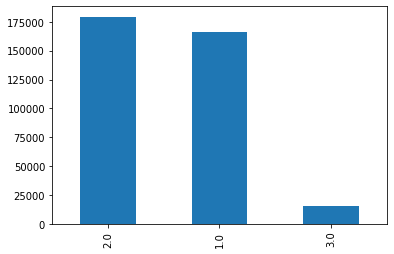

In [ ]:
ax = map_df['price'].value_counts().plot.bar()
# width=(0.5), figsize=(15,10)

ax.bar_label(ax.containers[0], fmt='%g')

plt.xticks([1.0, 2.0, 3.0], ['$', '$$', '$$$'])
plt.xticks(rotation=180)

plt.xlabel("Price")
plt.ylabel("No. of Places")
plt.show()

In [ ]:
# world_map = folium.Map()    
# world_map

In [ ]:
places

,name,gPlusPlaceId,price,address,lat,lon,city
0,T C's Referee Sports Bar,100327153115986850675,2.0,"[5322 W 26th St, Sioux Falls, SD 57106]",4.352949e+01,-9.679224e+01,NaN
1,Old Chicago,118222137795476771294,2.0,"[17960 NW Evergreen Pkwy, Beaverton, OR 97006]",4.553518e+01,-1.228622e+02,NaN
2,China Cottage,106432060150136868000,2.0,"[3718 Wilmington Pike, Dayton, OH 45429]",3.969290e+01,-8.413617e+01,NaN
3,Smokey Mountain Wings,100184392614713668281,2.0,"[3607 Outdoor Sportsman Pl, Kodak, TN 37764]",3.598598e+01,-8.361060e+01,NaN
4,Sabatinos Italian Kitchen,110300304875024740707,1.0,"[242 Massachusetts Ave, Arlington, MA 02474]",4.240690e+01,-7.114399e+01,NaN
...,...,...,...,...,...,...,...
360813,Coast Coffee Cafe,102445991423518108977,1.0,"[1269 Hay St, West Perth WA 6005, Australia]",-3.194821e+01,1.158403e+02,NaN
360814,Alvernon Donut Shop,105165247399326889634,1.0,"[1450 S Alvernon Way, Tucson, AZ 85711]",3.220395e+01,-1.109099e+02,NaN
360815,SUBWAY® Restaurants,102934499497015360471,1.0,"[Riverside Ave, Iron River, MI 49935]",4.608880e+07,-8.863522e+07,NaN
360816,Super Stop & Shop,109070835041469072310,2.0,"[1799 Farmington Ave, Unionville, CT 06085]",4.175697e+01,-7.288338e+01,NaN


In [ ]:
places = places.drop('city', axis=1)

# Main Work

## loading files

### review file

In [ ]:
df1 = pd.read_pickle('/content/drive/MyDrive/RS/reviews_merged_12345.pkl')

In [ ]:
df1 = df1.loc[~df1['reviewText'].isnull()]
df1 = df1.loc[~df1['categories'].isnull()]

In [ ]:
df1 = df1[df1['reviewText'].map(lambda x: x.isascii())]
df1 = df1[df1['reviewerName'].map(lambda x: x.isascii())]

In [ ]:
df1 = df1.drop(['reviewTime','unixReviewTime','reviewerName'], axis=1)

In [ ]:
df1

,rating,reviewText,categories,gPlusPlaceId,gPlusUserId
13,4.0,Best War Wanton soup in Red Bluff,"[Asian Restaurant, Chinese Restaurant]",106591714648856494903,100000032416892623125
14,5.0,This is a review that is long overdo. I've bee...,"[European Restaurant, Italian Restaurant, Pizz...",109420033090810328045,100000032416892623125
15,5.0,"Some authentic rub BBQ, great food and don't m...",[Barbecue Restaurant],111623070919810985923,100000032416892623125
16,4.0,Truly a Red Bluff standard. Great old fashione...,[Restaurant],113854191152597312098,100000032416892623125
17,5.0,"Long time favorite Mexican food, always consis...",[Mexican Restaurant],115827996910815192564,100000032416892623125
...,...,...,...,...,...
11453823,3.0,Counter people are very impatient.,"[Sandwich Shop, Fast Food Restaurant, Caterer]",116097431140849606669,118446742455312620560
11453825,5.0,really good.,[Stores and Shopping],116182623037527087333,118446742455312620560
11453827,2.0,Too expensive for a fast food burger.,"[Hamburger Restaurant, Fast Food Restaurant]",116458473784504954830,118446742455312620560
11453829,2.0,Too many gangs frequent this place.,[Flea Market],116649125736549598195,118446742455312620560


In [ ]:
df1.to_pickle('./review_12345.pkl')

### place file

In [ ]:
df = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/places_canada_us.pkl')

In [ ]:
df

,gPlusPlaceId,name,price
0,100327153115986850675,T C's Referee Sports Bar,2.0
1,118222137795476771294,Old Chicago,2.0
4,110300304875024740707,Sabatinos Italian Kitchen,1.0
12,114405340106573748286,Noodles & Company,2.0
22,114184193282144653801,One Eyed Jacks,2.0
...,...,...,...
360790,116930689768590287989,Dunkin' Donuts,1.0
360797,109410542827641391631,IHOP Restaurant,1.0
360801,114043871585802356425,Round's,2.0
360810,102610175166250357678,Buono Panini,2.0


### merging places and review file

In [ ]:
df1 = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/review_12345.pkl')

In [ ]:
result = df1.merge(df,on='gPlusPlaceId')

In [ ]:
result

,rating,reviewText,categories,gPlusPlaceId,gPlusUserId,name,price_cat
0,5.0,Glazer's has been great for professional suppo...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,100000205979559004579,Glazer's Camera,NaN
1,5.0,Great place. We were on vacation in Seattle a...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,100663373857317823895,Glazer's Camera,NaN
2,5.0,"Awesome, lucky to have in Seattle, will be bac...","[Camera Store, Audio Visual Equipment...]",102398625225928083037,104806891741178233945,Glazer's Camera,NaN
3,5.0,I have had two shopping experiences at Glazers...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,109050202677356770017,Glazer's Camera,NaN
4,4.0,"The only pro gear store left in town, as far a...","[Camera Store, Audio Visual Equipment...]",102398625225928083037,110719264043637716066,Glazer's Camera,NaN
...,...,...,...,...,...,...,...
221764,5.0,"Thank-you Pharmacists( Scott and Jade),Pharm T...",[Grocery Store],111431420145212547613,118443525321190041148,Safeway,NaN
221765,1.0,Will buy all my dvd at Wal-Mart or else where ...,"[DVD Store, Music Store]",114427356690699348222,118444881692249356277,F.Y.E.,NaN
221766,3.0,There are wonderful kind people who work here....,[Thrift Store],105979787412444138712,118445161012647682933,Salvation Army Thrift Store,NaN
221767,2.0,Staff would rather hang out and talk with thei...,"[European Restaurant, Italian Restaurant, Pub]",100930275397959110356,118445713199118604101,Bob McCullough's Pub,NaN


In [ ]:
result.to_pickle('./review_place_canada_us.pkl')

### user file

In [ ]:
df1 = pd.read_pickle('/content/drive/MyDrive/RS/users_unclear.pkl')

In [ ]:
df1

,userName,jobs,currentPlace,previousPlaces,education,gPlusUserId
0,an lam,"[[Tổng công ty IDICO, Chuyên viên Kỹ thuật XD,...","[Thành phố Hồ Chí Minh, Việt Nam, [[], 1082309...","[[tp. Nam Định, Nam Định, Việt Nam, [[], 20420...","[[[], [], [], [], [], 6], [[Đại học Kiến trúc ...",100000010817154263736
1,HALİL TURGUT,"[[Mustafa Nevzat İlaç San. A.Ş., Rebrezant, []...","[Adana, [[], 370000000, 353213330, 1]]",None,"[[[], [], [], [], [], 6], [[Anadolu University...",100000013500285534661
2,森田さとこ,None,None,None,"[[[], [], [], [], [], 6], []]",100000021336848867366
3,amey kore,None,None,None,"[[[], [], [], [], [], 6], []]",100000030557048145331
4,william spindler,None,None,None,"[[[], [], [], [], [], 6], []]",100000032416892623125
...,...,...,...,...,...,...
3747932,Andrei Mustea,None,None,None,"[[[], [], [], [], [], 6], []]",114675878141148336835
3747933,ahmed alalam,None,None,None,"[[[], [], [], [], [], 6], []]",114675879178455853299
3747934,Brad Shaffer,None,None,None,"[[[], [], [], [], [], 6], []]",114675884186004222559
3747935,Ashley Krueger,None,None,None,"[[[], [], [], [], [], 6], []]",114675887865682990096


In [ ]:
df1 = df1.loc[~df1['userName'].isnull()]
df1 = df1[df1['userName'].map(lambda x: x.isascii())]
df1 = df1.drop(['jobs','currentPlace','previousPlaces','education'], axis=1)

### merging review_place_canada_us & user file

In [ ]:
df = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/review_place_canada_us.pkl')

In [ ]:
result = df.merge(df1,on='gPlusUserId')

In [ ]:
result

,rating,reviewText,categories,gPlusPlaceId,gPlusUserId,name,price_cat,userName
0,5.0,Glazer's has been great for professional suppo...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower
1,5.0,Great place. We were on vacation in Seattle a...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis
2,5.0,"Awesome, lucky to have in Seattle, will be bac...","[Camera Store, Audio Visual Equipment...]",102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D
3,2.0,I ordered a sausage mcmuffin and got a stale o...,"[Fast Food Restaurant, Hamburger Restaurant]",115583898367618626397,104806891741178233945,McDonald's,NaN,Max D
4,5.0,I have had two shopping experiences at Glazers...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner
...,...,...,...,...,...,...,...,...
179071,5.0,Very FAST!!! Lovin' it!!!,"[Restaurant, Fast Food Restaurant, Hamburger R...",115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling
179072,5.0,I love this place just because of their frozen...,[Convenience Store],110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt
179073,5.0,"Nice mall. I'd kind of like to visit it, but t...",[Shoe Store],113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs
179074,2.0,They really have no services here; it's just a...,[Cell Phone Store],103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White


In [ ]:
result.to_pickle('./review&place&user_canada_us.pkl')

## making a file ready to clean

In [ ]:
df = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/review&place&user_canada_us.pkl')

In [ ]:
df

,rating,reviewText,categories,gPlusPlaceId,gPlusUserId,name,price_cat,userName
0,5.0,Glazer's has been great for professional suppo...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower
1,5.0,Great place. We were on vacation in Seattle a...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis
2,5.0,"Awesome, lucky to have in Seattle, will be bac...","[Camera Store, Audio Visual Equipment...]",102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D
3,2.0,I ordered a sausage mcmuffin and got a stale o...,"[Fast Food Restaurant, Hamburger Restaurant]",115583898367618626397,104806891741178233945,McDonald's,NaN,Max D
4,5.0,I have had two shopping experiences at Glazers...,"[Camera Store, Audio Visual Equipment...]",102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner
...,...,...,...,...,...,...,...,...
179071,5.0,Very FAST!!! Lovin' it!!!,"[Restaurant, Fast Food Restaurant, Hamburger R...",115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling
179072,5.0,I love this place just because of their frozen...,[Convenience Store],110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt
179073,5.0,"Nice mall. I'd kind of like to visit it, but t...",[Shoe Store],113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs
179074,2.0,They really have no services here; it's just a...,[Cell Phone Store],103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White


In [ ]:
def collapse(L):
    L1 = []
    for i in L:
        L1.append(i.replace(" ",""))
    return L1

In [ ]:
df['categories'] = df['categories'].apply(collapse)
df

,rating,reviewText,categories,gPlusPlaceId,gPlusUserId,name,price_cat,userName
0,5.0,Glazer's has been great for professional suppo...,"[CameraStore, AudioVisualEquipment...]",102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower
1,5.0,Great place. We were on vacation in Seattle a...,"[CameraStore, AudioVisualEquipment...]",102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis
2,5.0,"Awesome, lucky to have in Seattle, will be bac...","[CameraStore, AudioVisualEquipment...]",102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D
3,2.0,I ordered a sausage mcmuffin and got a stale o...,"[FastFoodRestaurant, HamburgerRestaurant]",115583898367618626397,104806891741178233945,McDonald's,NaN,Max D
4,5.0,I have had two shopping experiences at Glazers...,"[CameraStore, AudioVisualEquipment...]",102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner
...,...,...,...,...,...,...,...,...
179071,5.0,Very FAST!!! Lovin' it!!!,"[Restaurant, FastFoodRestaurant, HamburgerRest...",115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling
179072,5.0,I love this place just because of their frozen...,[ConvenienceStore],110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt
179073,5.0,"Nice mall. I'd kind of like to visit it, but t...",[ShoeStore],113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs
179074,2.0,They really have no services here; it's just a...,[CellPhoneStore],103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White


In [ ]:
df['reviewText'] = df['reviewText'].apply(lambda x:x.split())

In [ ]:
df['tags'] = df['reviewText'] + df['categories']
df

,rating,reviewText,categories,gPlusPlaceId,gPlusUserId,name,price_cat,userName,tags
0,5.0,"[Glazer's, has, been, great, for, professional...","[CameraStore, AudioVisualEquipment...]",102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower,"[Glazer's, has, been, great, for, professional..."
1,5.0,"[Great, place., We, were, on, vacation, in, Se...","[CameraStore, AudioVisualEquipment...]",102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis,"[Great, place., We, were, on, vacation, in, Se..."
2,5.0,"[Awesome,, lucky, to, have, in, Seattle,, will...","[CameraStore, AudioVisualEquipment...]",102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D,"[Awesome,, lucky, to, have, in, Seattle,, will..."
3,2.0,"[I, ordered, a, sausage, mcmuffin, and, got, a...","[FastFoodRestaurant, HamburgerRestaurant]",115583898367618626397,104806891741178233945,McDonald's,NaN,Max D,"[I, ordered, a, sausage, mcmuffin, and, got, a..."
4,5.0,"[I, have, had, two, shopping, experiences, at,...","[CameraStore, AudioVisualEquipment...]",102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner,"[I, have, had, two, shopping, experiences, at,..."
...,...,...,...,...,...,...,...,...,...
179071,5.0,"[Very, FAST!!!, Lovin', it!!!]","[Restaurant, FastFoodRestaurant, HamburgerRest...",115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling,"[Very, FAST!!!, Lovin', it!!!, Restaurant, Fas..."
179072,5.0,"[I, love, this, place, just, because, of, thei...",[ConvenienceStore],110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt,"[I, love, this, place, just, because, of, thei..."
179073,5.0,"[Nice, mall., I'd, kind, of, like, to, visit, ...",[ShoeStore],113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs,"[Nice, mall., I'd, kind, of, like, to, visit, ..."
179074,2.0,"[They, really, have, no, services, here;, it's...",[CellPhoneStore],103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White,"[They, really, have, no, services, here;, it's..."


In [ ]:
df = df.drop(columns=['reviewText','categories'])
df

,rating,gPlusPlaceId,gPlusUserId,name,price_cat,userName,tags
0,5.0,102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower,"[Glazer's, has, been, great, for, professional..."
1,5.0,102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis,"[Great, place., We, were, on, vacation, in, Se..."
2,5.0,102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D,"[Awesome,, lucky, to, have, in, Seattle,, will..."
3,2.0,115583898367618626397,104806891741178233945,McDonald's,NaN,Max D,"[I, ordered, a, sausage, mcmuffin, and, got, a..."
4,5.0,102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner,"[I, have, had, two, shopping, experiences, at,..."
...,...,...,...,...,...,...,...
179071,5.0,115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling,"[Very, FAST!!!, Lovin', it!!!, Restaurant, Fas..."
179072,5.0,110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt,"[I, love, this, place, just, because, of, thei..."
179073,5.0,113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs,"[Nice, mall., I'd, kind, of, like, to, visit, ..."
179074,2.0,103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White,"[They, really, have, no, services, here;, it's..."


In [ ]:
df['tags'] = df['tags'].apply(lambda x: " ".join(x))
df

,rating,gPlusPlaceId,gPlusUserId,name,price_cat,userName,tags
0,5.0,102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower,Glazer's has been great for professional suppo...
1,5.0,102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis,Great place. We were on vacation in Seattle an...
2,5.0,102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D,"Awesome, lucky to have in Seattle, will be bac..."
3,2.0,115583898367618626397,104806891741178233945,McDonald's,NaN,Max D,I ordered a sausage mcmuffin and got a stale o...
4,5.0,102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner,I have had two shopping experiences at Glazers...
...,...,...,...,...,...,...,...
179071,5.0,115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling,Very FAST!!! Lovin' it!!! Restaurant FastFoodR...
179072,5.0,110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt,I love this place just because of their frozen...
179073,5.0,113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs,"Nice mall. I'd kind of like to visit it, but t..."
179074,2.0,103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White,They really have no services here; it's just a...


In [ ]:
df.to_pickle('./ready_to_clean_us_canada.pkl')

## final preprocessing

In [ ]:
df = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/ready_to_clean_us_canada.pkl')

In [ ]:
df

,rating,gPlusPlaceId,gPlusUserId,name,price_cat,userName,tags
0,5.0,102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower,Glazer's has been great for professional suppo...
1,5.0,102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis,Great place. We were on vacation in Seattle an...
2,5.0,102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D,"Awesome, lucky to have in Seattle, will be bac..."
3,2.0,115583898367618626397,104806891741178233945,McDonald's,NaN,Max D,I ordered a sausage mcmuffin and got a stale o...
4,5.0,102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner,I have had two shopping experiences at Glazers...
...,...,...,...,...,...,...,...
179071,5.0,115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling,Very FAST!!! Lovin' it!!! Restaurant FastFoodR...
179072,5.0,110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt,I love this place just because of their frozen...
179073,5.0,113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs,"Nice mall. I'd kind of like to visit it, but t..."
179074,2.0,103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White,They really have no services here; it's just a...


In [ ]:
stopwords = stopwords.words('english')
df['tags'] = df['tags'].apply(lambda x : ' '.join( [word for word in (x).split() if word not in (stopwords)] ))
df

,rating,gPlusPlaceId,gPlusUserId,name,price_cat,userName,tags
0,5.0,102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower,Glazer's great professional support. I've gott...
1,5.0,102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis,Great place. We vacation Seattle needed access...
2,5.0,102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D,"Awesome, lucky Seattle, back again. CameraStor..."
3,2.0,115583898367618626397,104806891741178233945,McDonald's,NaN,Max D,I ordered sausage mcmuffin got stale overnight...
4,5.0,102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner,I two shopping experiences Glazers great. The ...
...,...,...,...,...,...,...,...
179071,5.0,115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling,Very FAST!!! Lovin' it!!! Restaurant FastFoodR...
179072,5.0,110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt,I love place frozen area. I love fresh meat re...
179073,5.0,113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs,"Nice mall. I'd kind like visit it, direction I..."
179074,2.0,103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White,They really services here; sales center place ...


In [ ]:
lemmatizer = WordNetLemmatizer()

def lemmatize_words(text):
  words = text.split()
  words = [lemmatizer.lemmatize(word,pos='v') for word in words]
  return ' '.join(words)

df['tags'] = df['tags'].apply(lemmatize_words)

In [ ]:
df

,rating,gPlusPlaceId,gPlusUserId,name,price_cat,userName,tags
0,5.0,102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower,Glazer's great professional support. I've get ...
1,5.0,102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis,Great place. We vacation Seattle need accessor...
2,5.0,102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D,"Awesome, lucky Seattle, back again. CameraStor..."
3,2.0,115583898367618626397,104806891741178233945,McDonald's,NaN,Max D,I order sausage mcmuffin get stale overnight l...
4,5.0,102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner,I two shop experience Glazers great. The sales...
...,...,...,...,...,...,...,...
179071,5.0,115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling,Very FAST!!! Lovin' it!!! Restaurant FastFoodR...
179072,5.0,110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt,I love place freeze area. I love fresh meat re...
179073,5.0,113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs,"Nice mall. I'd kind like visit it, direction I..."
179074,2.0,103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White,They really service here; sales center place p...


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer,CountVectorizer

tfidf = TfidfVectorizer(min_df=3 ,max_features=500, strip_accents= 'unicode',analyzer='word',token_pattern = r'\w{1,}',ngram_range=(1,3) )
tfidf_matrix = tfidf.fit_transform(df['tags'])

In [ ]:
tfidf_matrix = tfidf_matrix.toarray()

In [ ]:
tfidf_matrix 

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.12674219,
        0.11393114],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [ ]:
df = pd.DataFrame(tfidf_matrix)

In [ ]:
df

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,0.0,0.0,0.0,0.1725,0.0,0.0,0.0,0.0,0.0,0.0,...,0.200254,0.000000,0.0,0.0,0.171462,0.0,0.0,0.0,0.000000,0.000000
1,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
2,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
3,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
4,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.172758,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.146057
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179071,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
179072,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
179073,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
179074,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.126742,0.113931


In [ ]:
df.to_pickle('./tfidf_metrix_us_canada.pkl')

## tfidf of user and places

In [ ]:
df  = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/ready_to_clean_us_canada.pkl')

In [ ]:
user = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/tfidf_metric_us_canada.pkl')

In [ ]:
user['gPlusUserId'] = df['gPlusUserId']

In [ ]:
user

,0,1,2,3,4,5,6,7,8,9,...,491,492,493,494,495,496,497,498,499,gPlusUserId
0,0.0,0.0,0.0,0.1725,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.171462,0.0,0.0,0.0,0.000000,0.000000,100000205979559004579
1,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,100663373857317823895
2,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,104806891741178233945
3,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,104806891741178233945
4,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.172758,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.146057,109050202677356770017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179071,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,114664156215049038388
179072,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,114664630690342276529
179073,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,114666125137634459784
179074,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.126742,0.113931,114673365302308828573


In [ ]:
places = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/tfidf_metric_us_canada.pkl')

In [ ]:
places['gPlusPlaceId'] = df['gPlusPlaceId']

In [ ]:
places

,0,1,2,3,4,5,6,7,8,9,...,492,493,494,495,496,497,498,499,gPlusUserId,gPlusPlaceId
0,0.0,0.0,0.0,0.1725,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.171462,0.0,0.0,0.0,0.000000,0.000000,100000205979559004579,102398625225928083037
1,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,100663373857317823895,102398625225928083037
2,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,104806891741178233945,102398625225928083037
3,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,104806891741178233945,115583898367618626397
4,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.146057,109050202677356770017,102398625225928083037
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179071,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,114664156215049038388,115713977624151852362
179072,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,114664630690342276529,110358794830108520621
179073,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,114666125137634459784,113575758706356060269
179074,0.0,0.0,0.0,0.0000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.126742,0.113931,114673365302308828573,103071983134854832752


In [ ]:
user = user.groupby('gPlusUserId', as_index=False).mean()
user

,gPlusUserId,0,1,2,3,4,5,6,7,8,...,490,491,492,493,494,495,496,497,498,499
0,100000205979559004579,0.0,0.000000,0.000000,0.172500,0.0,0.00000,0.0,0.0,0.0,...,0.200254,0.000000,0.000000,0.0,0.171462,0.000000,0.000000,0.000000,0.0,0.0
1,100000524810171549476,0.0,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,...,0.000000,0.000000,0.138371,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
2,100000820235275835897,0.0,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.0,0.067560,0.000000,0.000000,0.000000,0.0,0.0
3,100000837200111327614,0.0,0.114728,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.084357,0.122299,0.000000,0.0,0.0
4,100000987095724371823,0.0,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100107,114674862239844583784,0.0,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.307864,0.0,0.0
100108,114675041715541482976,0.0,0.000000,0.000000,0.355575,0.0,0.00000,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0
100109,114675165676190288145,0.0,0.000000,0.000000,0.000000,0.0,0.29379,0.0,0.0,0.0,...,0.000000,0.154529,0.000000,0.0,0.000000,0.110496,0.000000,0.000000,0.0,0.0
100110,114675293468268213365,0.0,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.0,0.0,...,0.000000,0.000000,0.000000,0.0,0.197717,0.000000,0.000000,0.000000,0.0,0.0


In [ ]:
places = places.groupby('gPlusPlaceId', as_index=False).mean()
places

,gPlusPlaceId,0,1,2,3,4,5,6,7,8,...,490,491,492,493,494,495,496,497,498,499
0,100000257560958080089,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
1,100000572163336511356,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
2,100000786348254409611,0.000000,0.0,0.0,0.142049,0.000000,0.000000,0.0,0.080354,0.000000,...,0.0,0.0,0.000000,0.078295,0.0,0.00000,0.00000,0.173769,0.073941,0.000000
3,100001060161992807316,0.010267,0.0,0.0,0.049966,0.000000,0.113567,0.0,0.010402,0.048664,...,0.0,0.0,0.017607,0.000000,0.0,0.07445,0.01055,0.000000,0.019143,0.000000
4,100001248352519424640,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47791,118442754703466037970,0.000000,0.0,0.0,0.000000,0.000000,0.034194,0.0,0.110295,0.049198,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
47792,118443345548335576879,0.000000,0.0,0.0,0.000000,0.053067,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.042642
47793,118446375123325201008,0.259460,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
47794,118446402093988738953,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000


In [ ]:
user = np.array(user.iloc[:,1:])
places = np.array(places.iloc[:,1:])

In [ ]:
(pd.DataFrame(user)).to_pickle('./user_tfidf_us_canada.pkl')
(pd.DataFrame(places)).to_pickle('./places_tfidf_us_canada.pkl')

## cosine similarity

In [ ]:
user = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/user_tfidf_us_canada.pkl')
places = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/places_tfidf_us_canada.pkl')

In [ ]:
user.shape

(100112, 500)

In [ ]:
user = np.array(user)
places = np.array(places)

In [ ]:
cosine = []

In [ ]:
for i in range(0,10000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
import pickle

In [ ]:
with open('cosine1.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
cosine = []

In [ ]:
for i in range(10000,20000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine2.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
cosine = []

In [ ]:
for i in range(20000,30000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine3.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
for i in range(30000,40000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine4.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
for i in range(40000,50000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine5.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
for i in range(50000,60000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine6.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
for i in range(60000,70000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine7.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
for i in range(70000,80000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine8.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
for i in range(80000,90000):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine9.pkl','wb') as f:
     pickle.dump(cosine, f)

In [ ]:
for i in range(90000,100112):
  cosine.append(np.dot(user[i,:],places.T))

In [ ]:
with open('cosine10.pkl','wb') as f:
     pickle.dump(cosine, f)

## prediction

In [ ]:
import pandas as pd
import numpy as np

In [ ]:
df = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/ready_to_clean_us_canada.pkl')

In [ ]:
df = df.drop('price_cat', axis=1)

In [ ]:
# data = pd.read_csv('data.csv', encoding='latin-1')
# #cols = ['rating', 'gPlusPlaceId', 'gPlusUserId', 'name', 'userName', 'tags']
# data = data.iloc[:100, :]
# # Set css for html table
# css="{{ url_for('static',filename='css/df_style.css') }}"
# pd.set_option('colheader_justify', 'center')
# # HTML Table for file data
# html_string = '''
#                   <head>
#                       <link rel="stylesheet" type="text/css" href="{css}">
#                   </head>
#                   <body>
#                     {table}
#                   </body>
                
#                 '''
# html_table_data = html_string.format(table=data.to_html(classes='mystyle'),css=css)

# # Output an HTML file
# with open(os.path.join("data.html"), 'w', encoding="utf-8") as f:
#     f.write(html_table_data)
#     f.close()
# print(data)

In [ ]:
df = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/ready_to_clean_us_canada.pkl')

In [ ]:
df

,rating,gPlusPlaceId,gPlusUserId,name,price_cat,userName,tags
0,5.0,102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower,Glazer's has been great for professional suppo...
1,5.0,102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis,Great place. We were on vacation in Seattle an...
2,5.0,102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D,"Awesome, lucky to have in Seattle, will be bac..."
3,2.0,115583898367618626397,104806891741178233945,McDonald's,NaN,Max D,I ordered a sausage mcmuffin and got a stale o...
4,5.0,102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner,I have had two shopping experiences at Glazers...
...,...,...,...,...,...,...,...
179071,5.0,115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling,Very FAST!!! Lovin' it!!! Restaurant FastFoodR...
179072,5.0,110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt,I love this place just because of their frozen...
179073,5.0,113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs,"Nice mall. I'd kind of like to visit it, but t..."
179074,2.0,103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White,They really have no services here; it's just a...


In [ ]:
user = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/tfidf_metric_us_canada.pkl')

In [ ]:
user['gPlusUserId'] = df['gPlusUserId']

In [ ]:
places = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/tfidf_metric_us_canada.pkl')

In [ ]:
places['gPlusPlaceId'] = df['gPlusPlaceId']

In [ ]:
user = user.groupby('gPlusUserId', as_index=False).mean()
user

In [ ]:
places = places.groupby('gPlusPlaceId', as_index=False).mean()
places

,gPlusPlaceId,0,1,2,3,4,5,6,7,8,...,490,491,492,493,494,495,496,497,498,499
0,100000257560958080089,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
1,100000572163336511356,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
2,100000786348254409611,0.000000,0.0,0.0,0.142049,0.000000,0.000000,0.0,0.080354,0.000000,...,0.0,0.0,0.000000,0.078295,0.0,0.00000,0.00000,0.173769,0.073941,0.000000
3,100001060161992807316,0.010267,0.0,0.0,0.049966,0.000000,0.113567,0.0,0.010402,0.048664,...,0.0,0.0,0.017607,0.000000,0.0,0.07445,0.01055,0.000000,0.019143,0.000000
4,100001248352519424640,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47791,118442754703466037970,0.000000,0.0,0.0,0.000000,0.000000,0.034194,0.0,0.110295,0.049198,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
47792,118443345548335576879,0.000000,0.0,0.0,0.000000,0.053067,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.042642
47793,118446375123325201008,0.259460,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000
47794,118446402093988738953,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.000000,0.000000,0.0,0.00000,0.00000,0.000000,0.000000,0.000000


In [ ]:
user_id = pd.DataFrame(user['gPlusUserId'])

In [ ]:
user_id = user_id.merge(df,on='gPlusUserId')

In [ ]:
user_id = user_id.drop(['rating','gPlusPlaceId','name','price_cat','tags'],axis=1)
user_id = user_id.drop_duplicates()
user_id

In [ ]:
place_id = pd.DataFrame(places['gPlusPlaceId'])
place_id = place_id.merge(df,on='gPlusPlaceId')

In [ ]:
place_id

In [ ]:
place_id = place_id.drop(['rating','gPlusUserId','userName','price_cat','tags'],axis=1)
place_id = place_id.drop_duplicates()
place_id

,gPlusPlaceId,name
0,100000257560958080089,Pizza Time
2,100000572163336511356,Tim Hortons
3,100000786348254409611,"TCC, Verizon Wireless Premium Retailer"
4,100001060161992807316,Sprint
10,100001248352519424640,Gino's Pizza
...,...,...
179065,118442754703466037970,Original Thai 2
179069,118443345548335576879,Blarney's Sportsbar & Grill
179073,118446375123325201008,JCPenney
179074,118446402093988738953,Taco Bell


In [ ]:
user_id.to_pickle('user_id.pkl')
place_id.to_pickle('place_id.pkl')

In [ ]:
df = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/cosine.pkl')
df

[array([0.07795041, 0.03565657, 0.17775383, ..., 0.07660222, 0.03397652,
        0.        ]),
 array([0.04780339, 0.        , 0.00650972, ..., 0.        , 0.02846403,
        0.        ]),
 array([0.05225209, 0.03840684, 0.06912963, ..., 0.03287646, 0.03989153,
        0.        ]),
 array([0.07856253, 0.05186634, 0.21070856, ..., 0.05347872, 0.02099228,
        0.0277082 ]),
 array([0.16709895, 0.08883033, 0.        , ..., 0.        , 0.        ,
        0.04679959]),
 array([0.07944999, 0.04289664, 0.19343389, ..., 0.17850252, 0.04647873,
        0.12365959]),
 array([0.04552672, 0.22633575, 0.        , ..., 0.        , 0.        ,
        0.        ]),
 array([0.13808814, 0.08063233, 0.02703352, ..., 0.01219821, 0.04672138,
        0.07356915]),
 array([0.10090804, 0.03597405, 0.01664061, ..., 0.00574583, 0.03026392,
        0.05215453]),
 array([0.15058313, 0.10481113, 0.03853559, ..., 0.0158283 , 0.05414222,
        0.03311894]),
 array([0.04683031, 0.15110728, 0.        , ..., 0

In [ ]:
df1 = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/ready_to_clean_us_canada.pkl')

In [ ]:
df1

,rating,gPlusPlaceId,gPlusUserId,name,price_cat,userName,tags
0,5.0,102398625225928083037,100000205979559004579,Glazer's Camera,NaN,Alan Tower,Glazer's has been great for professional suppo...
1,5.0,102398625225928083037,100663373857317823895,Glazer's Camera,NaN,Beverly Davis,Great place. We were on vacation in Seattle an...
2,5.0,102398625225928083037,104806891741178233945,Glazer's Camera,NaN,Max D,"Awesome, lucky to have in Seattle, will be bac..."
3,2.0,115583898367618626397,104806891741178233945,McDonald's,NaN,Max D,I ordered a sausage mcmuffin and got a stale o...
4,5.0,102398625225928083037,109050202677356770017,Glazer's Camera,NaN,ashleigh baumgardner,I have had two shopping experiences at Glazers...
...,...,...,...,...,...,...,...
179071,5.0,115713977624151852362,114664156215049038388,McDonald's,NaN,anderson snelling,Very FAST!!! Lovin' it!!! Restaurant FastFoodR...
179072,5.0,110358794830108520621,114664630690342276529,Casey's General Store,NaN,Jess Hunt,I love this place just because of their frozen...
179073,5.0,113575758706356060269,114666125137634459784,SKECHERS,NaN,Brad Gibbs,"Nice mall. I'd kind of like to visit it, but t..."
179074,2.0,103071983134854832752,114673365302308828573,Sprint Store,NaN,Damon White,They really have no services here; it's just a...


In [ ]:
df1['gPlusUserId'].describe()

count                    179076
unique                   100112
top       107669470779452583961
freq                        279
Name: gPlusUserId, dtype: object

In [ ]:
place_list = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/place_id.pkl')
user_list = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/user_id.pkl')

In [ ]:
def prediction():
  n = input("Enter user Id : ")
  list1 = []
  for i in range(0,179076):
    if df1.iloc[i,2] == n:
      list1.append(df1.iloc[i,1])
  list2 = []
  id = user_list[user_list['gPlusUserId']==n].index.values
  for i in range(0,5000):
    if place_list.iloc[i,0] not in list1:
      list2.append( [place_list.iloc[i,0] ,place_list.iloc[i,1] , df[id[0]][i] ] )
  #list2 = (np.array(list2)).T
  sorted(list2,key=lambda x: x[2])
  list2 = pd.DataFrame(list2)
  print(list2.iloc[:2,:])

In [ ]:
prediction()

Enter user Id : 100000205979559004579
                       0            1         2
0  100000257560958080089   Pizza Time  0.077950
1  100000572163336511356  Tim Hortons  0.035657


In [ ]:
df2 = pd.read_pickle('/content/drive/MyDrive/RS/aayushi/places_cosine1.pkl')

In [ ]:
df2

[array([0.70912008, 0.15306279, 0.07167476, ..., 0.04525393, 0.        ,
        0.0591696 ]),
 array([0.15306279, 1.        , 0.00856078, ..., 0.02800446, 0.        ,
        0.14151806]),
 array([0.07167476, 0.00856078, 1.        , ..., 0.062276  , 0.02875983,
        0.        ]),
 array([0.06113663, 0.04641452, 0.31029733, ..., 0.04160106, 0.01087989,
        0.00421995]),
 array([0.21740928, 0.06443076, 0.02987606, ..., 0.00603864, 0.        ,
        0.02385338]),
 array([0.04070508, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]),
 array([0.08244498, 0.11477526, 0.11484684, ..., 0.00844763, 0.        ,
        0.10823745]),
 array([0.08040488, 0.02648789, 0.13439958, ..., 0.08040011, 0.06906815,
        0.30269159]),
 array([0.07009145, 0.06830772, 0.02463801, ..., 0.02263987, 0.00703924,
        0.03427726]),
 array([0.06582472, 0.09720621, 0.03941614, ..., 0.0150309 , 0.01355809,
        0.08056169]),
 array([0.04701454, 0.        , 0.        , ..., 0

In [ ]:
def multiround():
  n = input("Enter place Id : ")
  id = place_list[place_list['gPlusPlaceId']==n].index.values
  l = []
  for i in range(0,47796):
    l.append([place_list.iloc[i,0] , df2[0][i]])
  l = pd.DataFrame(l)
  l = l.sort_values(by=[1], ascending=False)
  return l.iloc[:2,:]

In [ ]:
p = multiround()

Enter place Id : 100000257560958080089


In [ ]:
p

,0,1
0,100000257560958080089,0.709120
975,100374474006438806615,0.554047
